This script was used to develop the network inversion alignment experiments.

We created a series of CNN layers and a series of GAN inverting those layers. 

We try to test if the layer is the "exact" inversion of the target layer it will be easier to perform activation maximization. 

Key technical points to consider:

* Preprocessin of images to ensure exact inversion. 
* Scaling of the optimizer to ensure the optimizer explore with a similar std as their original std. 
* Adding pixel generator as control???? 

In [1]:
%load_ext autoreload
%autoreload 2

In [37]:
import torch
import numpy as np
import torch as th
from circuit_toolkit.plot_utils import to_imgrid, show_imgrid, saveallforms, save_imgrid
from circuit_toolkit.GAN_utils import upconvGAN, Caffenet
from circuit_toolkit.Optimizers import CholeskyCMAES, CholeskyCMAES_torch, CholeskyCMAES_torch_noCMA
from circuit_toolkit.CNN_scorers import TorchScorer, resize_and_pad, resize_and_pad_tsr
from circuit_toolkit.layer_hook_utils import featureFetcher, featureFetcher_module
import pickle as pkl
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

In [13]:
CNN = Caffenet(pretrained=True)
CNN = CNN.cuda().eval()
CNN.requires_grad_(False)
G_dict = {}
for layer in ["norm1", "norm2", "conv3", "conv4", "pool5", "fc6", "fc6_eucl", "fc7", "fc8"]:
    G_dict[layer] = upconvGAN(name=layer, pretrained=True).cuda().eval()
    G_dict[layer].requires_grad_(False)

In [4]:
invers_layer_map = {
    "norm1": 3,
    "norm2": 7,
    "conv3": 9,
    "conv4": 11,
    "pool5": 14,
    "fc6": 17,
    "fc6_eucl": 17,
    "fc7": 19,
    "fc8": 20,
}

In [5]:
CNNlayerlist = list(CNN.net._modules.keys())
for k, v in invers_layer_map.items():
    print(f"{k}: {CNNlayerlist[v]}")

norm1: norm1
norm2: norm2
conv3: relu3
conv4: relu4
pool5: pool5
fc6: relu6
fc6_eucl: relu6
fc7: relu7
fc8: fc8


### CaffeNet and GAN latent statistics 

In [7]:
from tqdm.auto import tqdm
import torch.nn.functional as F
from torch.utils.data import DataLoader
from IPython.display import display
from circuit_toolkit.GAN_utils import RGB_mean
from circuit_toolkit.layer_hook_utils import featureFetcher_module
from circuit_toolkit.dataset_utils import create_imagenet_valid_dataset
INroot = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Datasets/imagenet-valid/"
INdataset = create_imagenet_valid_dataset(imgpix=227, normalize=False, rootdir=INroot)

In [8]:
CNN = Caffenet(pretrained=True)
CNN = CNN.cuda().eval()
CNN.requires_grad_(False)

Caffenet(
  (net): Sequential(
    (conv1): Conv2d(3, 96, kernel_size=(11, 11), stride=(4, 4))
    (relu1): ReLU(inplace=True)
    (pool1): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=True)
    (norm1): LocalResponseNorm(5, alpha=0.0001, beta=0.75, k=1.0)
    (conv2): Conv2d(96, 256, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2), groups=2)
    (relu2): ReLU(inplace=True)
    (pool2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=True)
    (norm2): LocalResponseNorm(5, alpha=0.0001, beta=0.75, k=1.0)
    (conv3): Conv2d(256, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (relu3): ReLU(inplace=True)
    (conv4): Conv2d(384, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=2)
    (relu4): ReLU(inplace=True)
    (conv5): Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=2)
    (relu5): ReLU(inplace=True)
    (pool5): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=True)

In [14]:
fetcher = featureFetcher_module(store_device="cuda")
for layer, index in invers_layer_map.items():
    if layer == "fc6_eucl":
        continue
    fetcher.record_module(CNN.net[index], target_name=layer, )

norm1


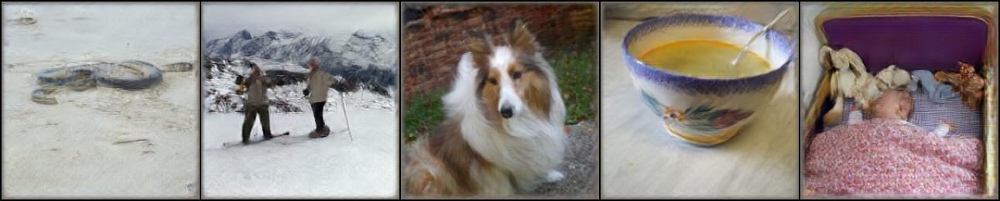

norm2


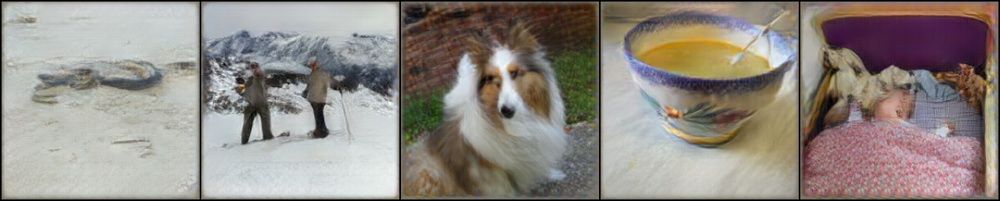

conv3


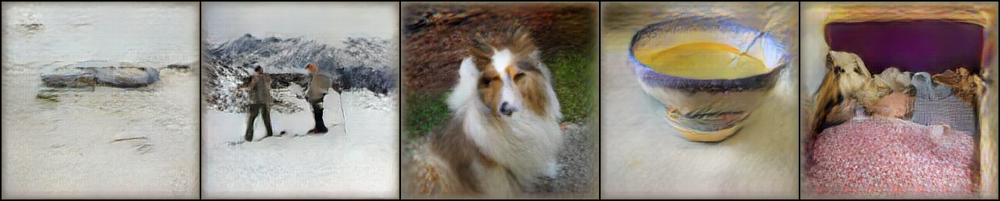

conv4


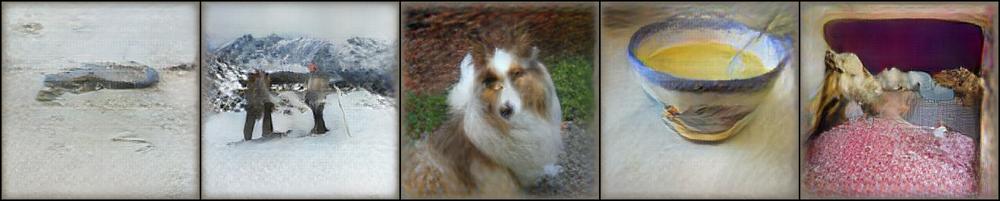

pool5


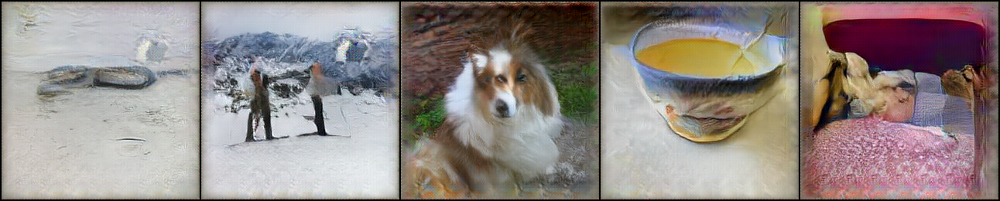

fc6


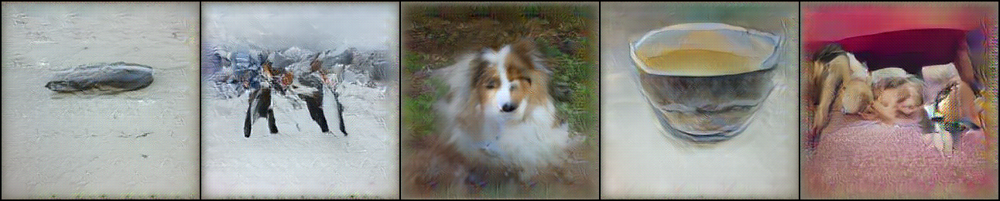

fc7


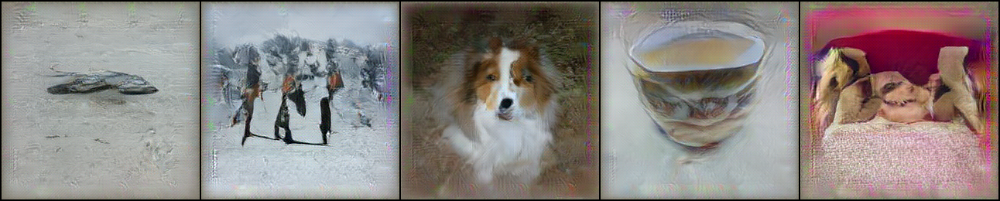

fc8


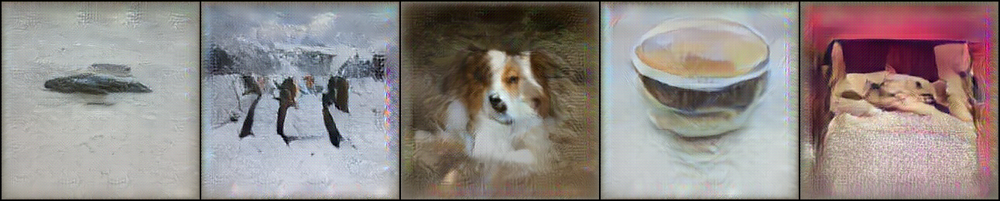

In [15]:
dataloader = DataLoader(INdataset, batch_size=5, shuffle=False, num_workers=0)
imgtsr, _ = next(iter(dataloader))
# imgtsr_pp = ((imgtsr * 255.0) - RGB_mean)[:, [2, 1, 0], :, :]
with torch.no_grad():
    out = CNN(imgtsr.cuda(), preproc=True)

recon_img_col = {}
for k, v in fetcher.activations.items():
    print(k)
    recon_img = G_dict[k].visualize(v).cpu()
    # interpolate to 256x256
    recon_img = th.nn.functional.interpolate(recon_img, size=(256, 256), mode="bilinear")
    recon_img_col[k] = recon_img
    # show_imgrid(recon_img, nrow=5)
    display(to_imgrid(recon_img, nrow=5))

### Activation statistics 

In [26]:
savedir = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Projects/ReprInvertNet"
dataloader = DataLoader(INdataset, batch_size=512, shuffle=False, num_workers=8)
activ_sum = {}
activ_sum_sq = {}
activ_mean = {}
activ_std = {}
for imgtsr, _ in tqdm(dataloader):
    with torch.no_grad():
        out = CNN(imgtsr.cuda(), preproc=True)
    for k, v in fetcher.activations.items():
        activ_sum[k] = activ_sum.get(k, 0) + v.sum(dim=0)
        activ_sum_sq[k] = activ_sum_sq.get(k, 0) + (v**2).sum(dim=0)

for k in activ_sum.keys():
    activ_mean[k] = activ_sum[k] / len(INdataset)
    activ_std[k] = (activ_sum_sq[k] / len(INdataset) - activ_mean[k]**2)**0.5

pkl.dump({"mean": activ_mean, "std": activ_std}, open(f"{savedir}/caffenet_activ_stats.pkl", "wb"))

  0%|          | 0/98 [00:00<?, ?it/s]

In [31]:
# make sure the stats are correct, no nan
for k in activ_mean.keys():
    assert not torch.isnan(activ_sum[k]).any()
    assert not torch.isnan(activ_sum_sq[k]).any()
    assert not torch.isnan(activ_mean[k]).any()
    assert not torch.isnan(activ_std[k]).any()
    print(f"{k}: {activ_mean[k].shape}, {activ_mean[k].mean():.2f} ± {activ_std[k].mean():.2f}")

norm1: torch.Size([96, 27, 27]), 30.34 ± 28.67
norm2: torch.Size([256, 13, 13]), 15.62 ± 23.84
conv3: torch.Size([384, 13, 13]), 10.04 ± 19.35
conv4: torch.Size([384, 13, 13]), 6.56 ± 12.90
pool5: torch.Size([256, 6, 6]), 5.01 ± 11.95
fc6: torch.Size([4096]), 1.12 ± 3.65
fc7: torch.Size([4096]), 0.40 ± 1.13
fc8: torch.Size([1000]), 0.00 ± 2.94


In [32]:
dataloader = DataLoader(INdataset, batch_size=1024, shuffle=True, num_workers=8)
# imgtsr, _ = next(iter(dataloader))
for imgtsr, _ in dataloader:
    with torch.no_grad():
        out = CNN(imgtsr.cuda(), preproc=True)
    break

for k, v in fetcher.activations.items():
    print(k, v.shape, f"{v.mean():.2f} ± {v.std():.2f}, norm: {v.flatten(start_dim=1).norm(dim=(1)).mean():.2f}")

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x15243a533400>
Traceback (most recent call last):
  File "/n/home12/binxuwang/.conda/envs/torch2/lib/python3.10/site-packages/torch/utils/data/dataloader.py", line 1479, in __del__
    self._shutdown_workers()
  File "/n/home12/binxuwang/.conda/envs/torch2/lib/python3.10/site-packages/torch/utils/data/dataloader.py", line 1462, in _shutdown_workers
    if w.is_alive():
  File "/n/home12/binxuwang/.conda/envs/torch2/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x15243a533400>
Traceback (most recent call last):
  File "/n/home12/binxuwang/.conda/envs/torch2/lib/python3.10/site-packages/torch/utils/data/dataloader.py", line 1479, in __del__
    self._shutdown_workers()
  File "/n/home12/binxuwang/.cond

norm1 torch.Size([1024, 96, 27, 27]) 30.08 ± 31.19, norm: 11372.98
norm2 torch.Size([1024, 256, 13, 13]) 15.42 ± 25.82, norm: 6214.25
conv3 torch.Size([1024, 384, 13, 13]) 10.00 ± 21.52, norm: 6020.43
conv4 torch.Size([1024, 384, 13, 13]) 6.50 ± 14.02, norm: 3909.86
pool5 torch.Size([1024, 256, 6, 6]) 4.96 ± 12.13, norm: 1238.64
fc6 torch.Size([1024, 4096]) 1.11 ± 3.65, norm: 238.69
fc7 torch.Size([1024, 4096]) 0.41 ± 1.15, norm: 76.65
fc8 torch.Size([1024, 1000]) 0.00 ± 3.10, norm: 95.98


### Visualize the average image?

In [ ]:
G_dict = {}
for layer in ["norm1", "norm2", "conv3", "conv4", "pool5", "fc6", "fc6_eucl", "fc7", "fc8"]:
    G_dict[layer] = upconvGAN(name=layer, pretrained=True).cuda().eval()
    G_dict[layer].requires_grad_(False)

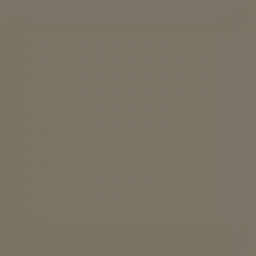

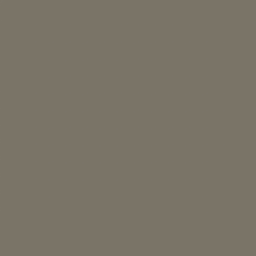

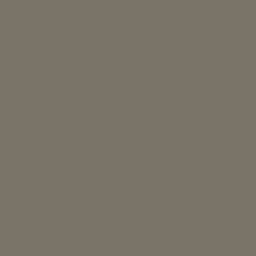

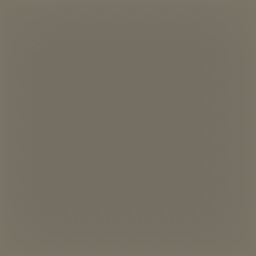

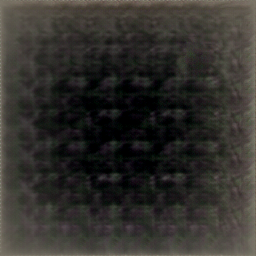

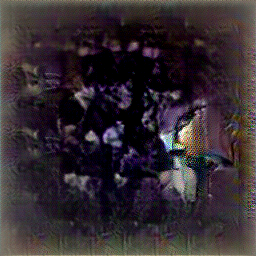

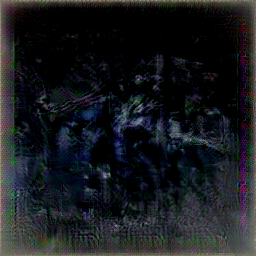

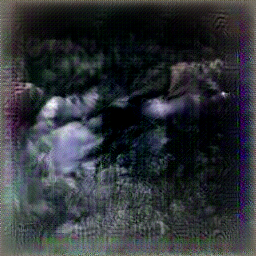

In [39]:
for layer, actmean in activ_mean.items():
    zero_vec = torch.zeros(1, *G_dict[layer].latent_shape, device='cuda')
    recon_img = G_dict[layer].visualize(zero_vec).cpu()
    recon_img = th.nn.functional.interpolate(recon_img, size=(256, 256), mode="bilinear")
    display(to_imgrid(recon_img, nrow=1))
    save_imgrid(recon_img, f"{savedir}/caffenet_activ_mean_{layer}_GANrecon_zero.png")

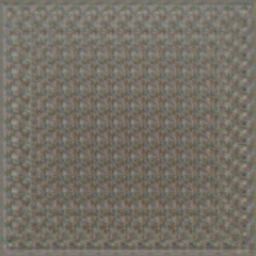

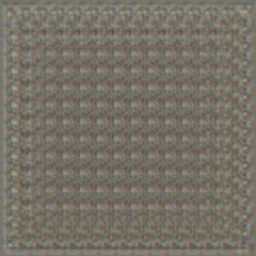

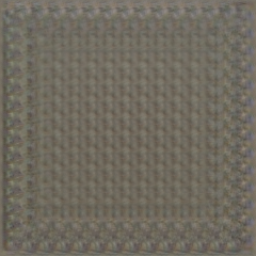

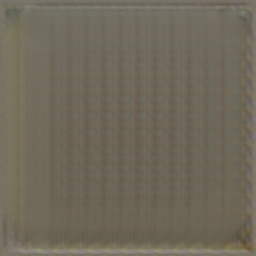

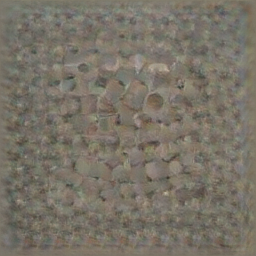

...

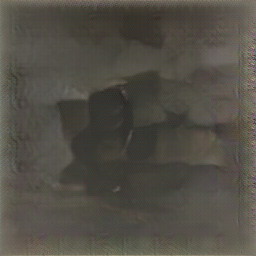

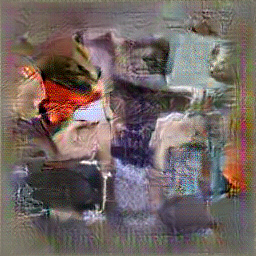

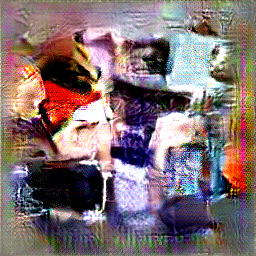

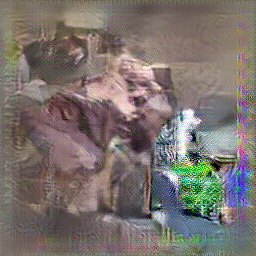

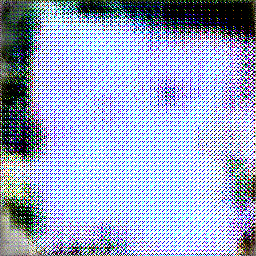

In [38]:
for layer, actmean in activ_mean.items():
    recon_img = G_dict[layer].visualize(actmean[None, ...]).cpu()
    recon_img = th.nn.functional.interpolate(recon_img, size=(256, 256), mode="bilinear")
    display(to_imgrid(recon_img, nrow=1))
    save_imgrid(recon_img, f"{savedir}/caffenet_activ_mean_{layer}_GANrecon.png")
    recon_img_std = G_dict[layer].visualize(activ_std[layer][None, ...]).cpu()
    recon_img_std = th.nn.functional.interpolate(recon_img_std, size=(256, 256), mode="bilinear")
    display(to_imgrid(recon_img_std, nrow=1))
    save_imgrid(recon_img_std, f"{savedir}/caffenet_activ_std_{layer}_GANrecon.png")

### Pilot 5: Statistically tuned optimizers for each generative space

In [65]:
for k, v in activ_mean.items():
    print(k, v.shape, f"{v.mean():.2f} ± {v.std():.2f}")

norm1 torch.Size([96, 27, 27]) 30.34 ± 10.64
norm2 torch.Size([256, 13, 13]) 15.62 ± 8.54
conv3 torch.Size([384, 13, 13]) 10.04 ± 7.77
conv4 torch.Size([384, 13, 13]) 6.56 ± 4.47
pool5 torch.Size([256, 6, 6]) 5.01 ± 1.42
fc6 torch.Size([4096]) 1.12 ± 0.22
fc7 torch.Size([4096]) 0.40 ± 0.07
fc8 torch.Size([1000]) 0.00 ± 0.83


In [69]:
evolsavedir = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Projects/ReprInvertNet_Evol"
total_steps = 100
print_freq = 100
RFresize = True
corner = (0, 0)
imgsize = (224, 224)
std_scaling_factor = 0.5
with open(f"{savedir}/caffenet_activ_stats.pkl", "rb") as f:
    stats = pkl.load(f)
    activ_mean, activ_std = stats["mean"], stats["std"]
results_collection = []
for unit_idx in range(20, 40):
    for layerkey in ["fc8", "relu7", "relu6", "pool5", "relu3", "norm2"]:
        for GAN_key in ["fc8", "fc7", "fc6", "pool5", "conv3", "norm2"]:
            print(f"CNN layer: {layerkey}, GAN layer: {GAN_key}")
            G = G_dict[GAN_key]
            fetcher = featureFetcher_module()
            fetcher.record_module(CNN.net.__getattr__(layerkey), target_name=layerkey)
            code_len = np.prod(G.latent_shape)
            # use the mean of the layer activation as initialization
            new_codes = activ_mean[GAN_key][None, ...].flatten(start_dim=1) ##[unit_idx]
            init_sigma = activ_std[GAN_key].mean().item() * std_scaling_factor
            assert not np.isnan(init_sigma)
            optimizer = CholeskyCMAES_torch_noCMA(code_len, init_sigma=init_sigma, Aupdate_freq=1000, device='cuda')
            # new_codes = torch.randn(1, code_len, device='cuda') #np.random.randn(1, code_len)
            scores_all = []
            generations = []
            codes_all = []
            best_imgs = []
            with torch.no_grad():
                for i in range(total_steps,):
                    codes_all.append(new_codes.cpu().numpy())
                    latent_code = new_codes.view(-1, *G.latent_shape)
                    imgs = G.visualize(latent_code)#.cuda().cpu()
                    if RFresize:
                        imgs = resize_and_pad_tsr(imgs, imgsize, corner, canvas_size=imgsize, )  #  Bug: imgs are resized to 256x256 and it will be further resized in score_tsr
                    CNN(imgs, preproc=True)
                    activations = fetcher[layerkey]
                    if activations.ndim == 2:
                        scores = activations[:, unit_idx] #.cpu().numpy() #scorer.score_tsr(imgs)
                    elif activations.ndim == 4:
                        center_idx = tuple(dim // 2 for dim in activations.shape[-2:])
                        scores = activations[:, unit_idx, center_idx[0], center_idx[1]]
                    else:
                        raise ValueError(f"Unsupported activation dimension: {activations.ndim}")
                    if i % print_freq == 0 or i == total_steps - 1:
                        print("step %d score %.3f (%.3f) (norm %.2f )" % (
                            i, scores.mean().cpu(), scores.std().cpu(), latent_code.view(-1, code_len).norm(dim=1).mean().cpu(),))
                    new_codes = optimizer.step_simple(scores, new_codes, verbosity=False)
                    scores_all.extend(list(scores.cpu().numpy()))
                    generations.extend([i] * len(scores))
                    best_imgs.append(imgs[scores.argmax(),:,:,:].cpu())
            print(f"CNN {layerkey}-unit {unit_idx} | GAN {GAN_key}: last gen avg score: {scores.cpu().mean()}")
            fetcher.cleanup()
            del optimizer
            results_collection.append({
                "CNN": layerkey,
                "GAN": GAN_key,
                "unit_idx": unit_idx,
                "final_score": scores.cpu().mean().item(),
                "final_best_img": best_imgs[-1].cpu(),
                "scores": scores_all,
                "generations": generations,
                # "best_imgs": best_imgs,
            })

pkl.dump(results_collection, open(f"{evolsavedir}/results_collection_noCMA_pilot5_preproc_optimtuned.pkl", "wb"))

CNN layer: fc8, GAN layer: fc8
FeatureFetcher hooks all freed
Space dimension: 1000, Population size: 33, Select size:16, Optimization Parameters:
Initial sigma: 1.470
cc=0.004, cs=0.089, c1=0.000, damps=1.089
step 0 score -2.555 (nan) (norm 26.29 )


/tmp/ipykernel_3456921/3958932021.py:48: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at /opt/conda/conda-bld/pytorch_1716905979055/work/aten/src/ATen/native/ReduceOps.cpp:1807.)
  i, scores.mean().cpu(), scores.std().cpu(), latent_code.norm(dim=1).mean().cpu(),))


step 99 score 37.756 (3.380) (norm 126.98 )
CNN fc8-unit 20 | GAN fc8: last gen avg score: 37.75569534301758
FeatureFetcher hooks all freed
CNN layer: fc8, GAN layer: fc7
FeatureFetcher hooks all freed
Space dimension: 4096, Population size: 40, Select size:20, Optimization Parameters:
Initial sigma: 0.567
cc=0.001, cs=0.050, c1=0.000, damps=1.050
step 0 score -1.713 (nan) (norm 26.27 )
step 99 score 42.499 (2.793) (norm 92.91 )
CNN fc8-unit 20 | GAN fc7: last gen avg score: 42.499061584472656
FeatureFetcher hooks all freed
CNN layer: fc8, GAN layer: fc6
FeatureFetcher hooks all freed
Space dimension: 4096, Population size: 40, Select size:20, Optimization Parameters:
Initial sigma: 1.825
cc=0.001, cs=0.050, c1=0.000, damps=1.050
step 0 score -0.812 (nan) (norm 72.95 )
step 99 score 62.848 (2.207) (norm 309.27 )
CNN fc8-unit 20 | GAN fc6: last gen avg score: 62.848243713378906
FeatureFetcher hooks all freed
CNN layer: fc8, GAN layer: pool5
FeatureFetcher hooks all freed
Space dimension

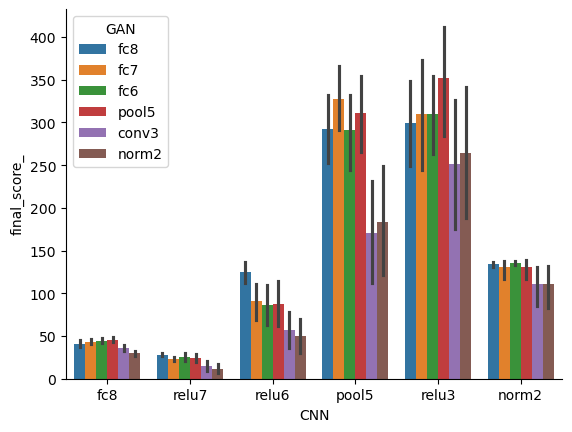

In [70]:
df = pd.DataFrame(results_collection)
df.head()
df["final_score_"] = df["final_score"]#.map(lambda x:x.item())
sns.barplot(x="CNN", y="final_score_", data=df, hue="GAN", )
plt.show()

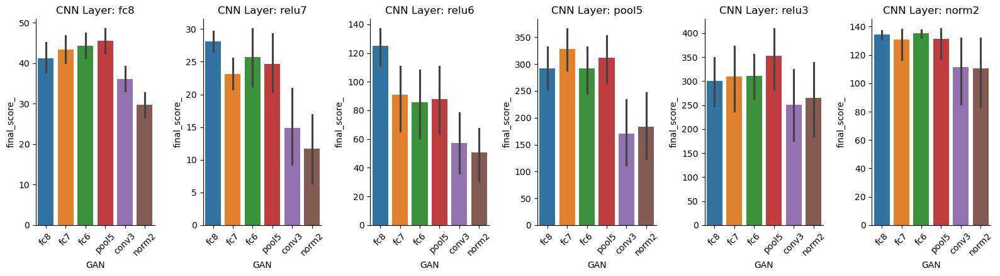

In [71]:
# Create a figure with 6 subplots, one for each CNN layer
fig, axes = plt.subplots(1, 6, figsize=(16, 4.5))
axes = axes.flatten()
# Get unique CNN layers
cnn_layers = df["CNN"].unique()
# Create a subplot for each CNN layer
for i, cnn_layer in enumerate(cnn_layers):
    # Filter data for this CNN layer
    layer_data = df[df["CNN"] == cnn_layer]
    # Create swarm plot
    # sns.stripplot(x="GAN", y="final_score_", data=layer_data, ax=axes[i], dodge=True, hue="GAN", alpha=0.5)
    sns.barplot(x="GAN", y="final_score_", data=layer_data, ax=axes[i], hue="GAN",  )
    axes[i].set_title(f'CNN Layer: {cnn_layer}')
    axes[i].tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

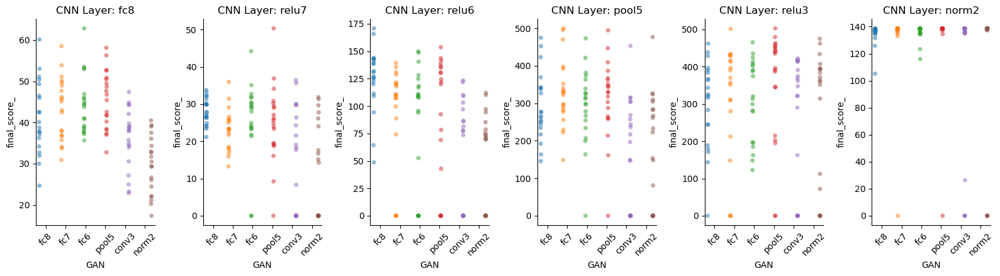

In [72]:
# Create a figure with 6 subplots, one for each CNN layer
fig, axes = plt.subplots(1, 6, figsize=(16, 4.5))
axes = axes.flatten()
# Get unique CNN layers
cnn_layers = df["CNN"].unique()
# Create a subplot for each CNN layer
for i, cnn_layer in enumerate(cnn_layers):
    # Filter data for this CNN layer
    layer_data = df[df["CNN"] == cnn_layer]
    # Create swarm plot
    sns.stripplot(x="GAN", y="final_score_", data=layer_data, ax=axes[i], dodge=True, hue="GAN", alpha=0.5)
    # sns.barplot(x="GAN", y="final_score_", data=layer_data, ax=axes[i], hue="GAN",  )
    axes[i].set_title(f'CNN Layer: {cnn_layer}')
    axes[i].tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

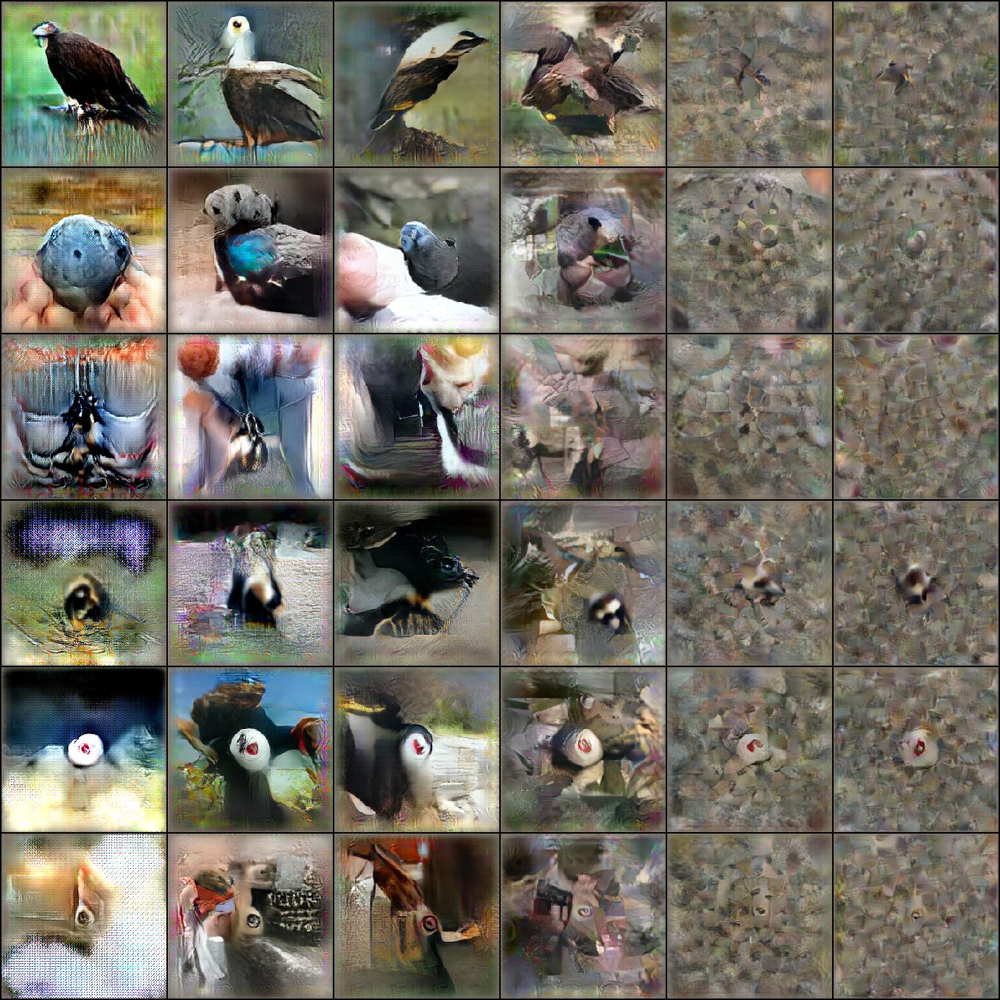

In [74]:
imgcol = []
for i in range(36, 72):
    imgcol.append(df.iloc[i].final_best_img)
display(to_imgrid(imgcol, nrow=6))

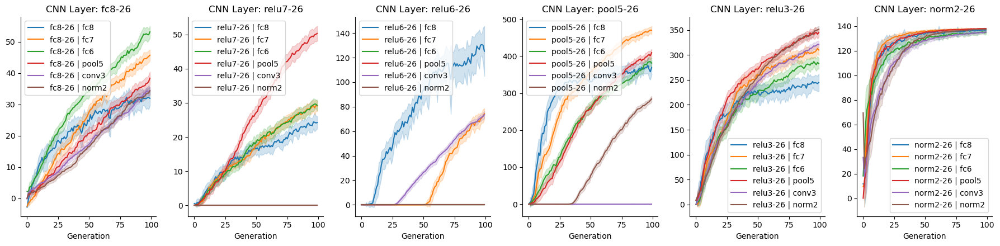

In [100]:
# plt.scatter(df.iloc[11]["generations"], 
#             df.iloc[11]["scores"], )
offset = 216
figh, axs = plt.subplots(1, 6, figsize=(18, 4.5))
axs = axs.flatten()
for i, ax in enumerate(axs):
    for j in range(6):
        sns.lineplot(x=df.iloc[offset+i*6+j]["generations"], y=df.iloc[offset+i*6+j]["scores"], 
                 errorbar="sd", label=f"{df.iloc[offset+i*6+j]['CNN']}-{df.iloc[offset+i*6+j]['unit_idx']} | {df.iloc[offset+i*6+j]['GAN']}", ax=ax)# data=df.iloc[11])
    ax.set_title(f"CNN Layer: {df.iloc[offset+i*6]['CNN']}-{df.iloc[offset+i*6]['unit_idx']}")
    ax.set_xlabel("Generation")
    # ax.set_ylabel("Score")
plt.tight_layout()
plt.show()

In [75]:
df[["CNN", "unit_idx", "GAN", "final_score"]].head(12)

,CNN,unit_idx,GAN,final_score
0,fc8,20,fc8,37.755695
1,fc8,20,fc7,42.499062
2,fc8,20,fc6,62.848244
3,fc8,20,pool5,48.686108
4,fc8,20,conv3,42.099987
5,fc8,20,norm2,40.494820
6,relu7,20,fc8,26.356073
7,relu7,20,fc7,25.810375
8,relu7,20,fc6,29.589325
9,relu7,20,pool5,25.697124


### Pilot 4: add correct preprocessing for CNN (without optimizer tuning)

In [40]:
evolsavedir = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Projects/ReprInvertNet_Evol"
total_steps = 100
print_freq = 100
RFresize = True
corner = (0, 0)
imgsize = (224, 224)
# unit_idx = 20
# layerkey = 'fc7'
# GAN_key = 'fc6'
results_collection = []
for unit_idx in range(20, 30):
    for layerkey in ["fc8", "relu7", "relu6", "pool5", "relu3", "norm2"]:
        for GAN_key in ["fc8", "fc7", "fc6", "pool5", "conv3", "norm2"]:
            print(f"CNN layer: {layerkey}, GAN layer: {GAN_key}")
            G = G_dict[GAN_key]
            fetcher = featureFetcher_module()
            fetcher.record_module(CNN.net.__getattr__(layerkey), target_name=layerkey)
            code_len = np.prod(G.latent_shape)
            optimizer = CholeskyCMAES_torch_noCMA(code_len, init_sigma=1, Aupdate_freq=1000, device='cuda')
            new_codes = torch.randn(1, code_len, device='cuda') #np.random.randn(1, code_len)
            scores_all = []
            generations = []
            codes_all = []
            best_imgs = []
            with torch.no_grad():
                for i in range(total_steps,):
                    codes_all.append(new_codes.cpu().numpy())
                    latent_code = new_codes.view(-1, *G.latent_shape)
                    imgs = G.visualize(latent_code)#.cuda().cpu()
                    if RFresize:
                        imgs = resize_and_pad_tsr(imgs, imgsize, corner, canvas_size=imgsize, )  #  Bug: imgs are resized to 256x256 and it will be further resized in score_tsr
                    CNN(imgs, preproc=True)
                    activations = fetcher[layerkey]
                    if activations.ndim == 2:
                        scores = activations[:, unit_idx] #.cpu().numpy() #scorer.score_tsr(imgs)
                    elif activations.ndim == 4:
                        center_idx = tuple(dim // 2 for dim in activations.shape[-2:])
                        scores = activations[:, unit_idx, center_idx[0], center_idx[1]]
                    else:
                        raise ValueError(f"Unsupported activation dimension: {activations.ndim}")
                    if i % print_freq == 0 or i == total_steps - 1:
                        print("step %d score %.3f (%.3f) (norm %.2f )" % (
                            i, scores.mean().cpu(), scores.std().cpu(), latent_code.norm(dim=1).mean().cpu(),))
                    new_codes = optimizer.step_simple(scores, new_codes, verbosity=False)
                    scores_all.extend(list(scores.cpu().numpy()))
                    generations.extend([i] * len(scores))
                    best_imgs.append(imgs[scores.argmax(),:,:,:].cpu())
            print(f"CNN {layerkey}-unit {unit_idx} | GAN {GAN_key}: last gen avg score: {scores.cpu().mean()}")
            fetcher.cleanup()
            del optimizer
            results_collection.append({
                "CNN": layerkey,
                "GAN": GAN_key,
                "unit_idx": unit_idx,
                "final_score": scores.cpu().mean().item(),
                "final_best_img": best_imgs[-1].cpu(),
                "scores": scores_all,
                "generations": generations,
                # "best_imgs": best_imgs,
            })

pkl.dump(results_collection, open(f"{evolsavedir}/results_collection_noCMA_pilot4_preproc.pkl", "wb"))

CNN layer: fc8, GAN layer: fc8
Space dimension: 1000, Population size: 33, Select size:16, Optimization Parameters:
Initial sigma: 1.000
cc=0.004, cs=0.089, c1=0.000, damps=1.089
step 0 score -0.458 (nan) (norm 31.39 )


/tmp/ipykernel_3456921/522415142.py:43: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at /opt/conda/conda-bld/pytorch_1716905979055/work/aten/src/ATen/native/ReduceOps.cpp:1807.)
  i, scores.mean().cpu(), scores.std().cpu(), latent_code.norm(dim=1).mean().cpu(),))


step 99 score 36.180 (4.693) (norm 91.74 )
CNN fc8-unit 20 | GAN fc8: last gen avg score: 36.180450439453125
FeatureFetcher hooks all freed
CNN layer: fc8, GAN layer: fc7
FeatureFetcher hooks all freed
Space dimension: 4096, Population size: 40, Select size:20, Optimization Parameters:
Initial sigma: 1.000
cc=0.001, cs=0.050, c1=0.000, damps=1.050
step 0 score 2.216 (nan) (norm 62.97 )
step 99 score 54.960 (5.377) (norm 168.74 )
CNN fc8-unit 20 | GAN fc7: last gen avg score: 54.9598503112793
FeatureFetcher hooks all freed
CNN layer: fc8, GAN layer: fc6
FeatureFetcher hooks all freed
Space dimension: 4096, Population size: 40, Select size:20, Optimization Parameters:
Initial sigma: 1.000
cc=0.001, cs=0.050, c1=0.000, damps=1.050
step 0 score -2.164 (nan) (norm 62.79 )
step 99 score 43.310 (2.356) (norm 169.57 )
CNN fc8-unit 20 | GAN fc6: last gen avg score: 43.310325622558594
FeatureFetcher hooks all freed
CNN layer: fc8, GAN layer: pool5
FeatureFetcher hooks all freed
Space dimension: 

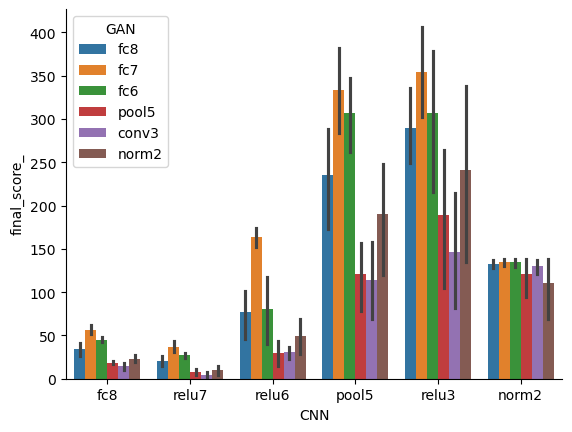

In [41]:
df = pd.DataFrame(results_collection)
df.head()
df["final_score_"] = df["final_score"]#.map(lambda x:x.item())
sns.barplot(x="CNN", y="final_score_", data=df, hue="GAN", )
plt.show()

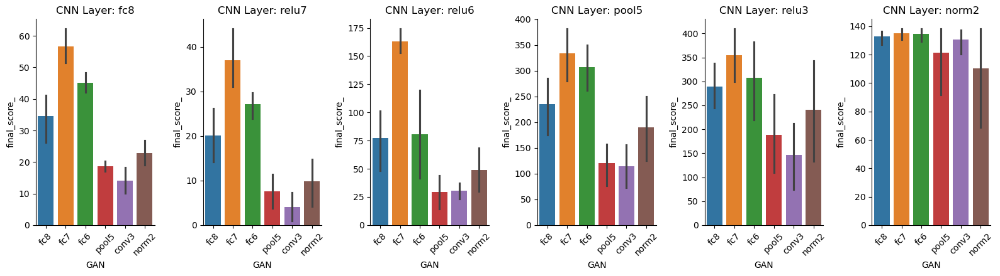

In [43]:
# Create a figure with 6 subplots, one for each CNN layer
fig, axes = plt.subplots(1, 6, figsize=(16, 4.5))
axes = axes.flatten()
# Get unique CNN layers
cnn_layers = df["CNN"].unique()
# Create a subplot for each CNN layer
for i, cnn_layer in enumerate(cnn_layers):
    # Filter data for this CNN layer
    layer_data = df[df["CNN"] == cnn_layer]
    # Create swarm plot
    # sns.stripplot(x="GAN", y="final_score_", data=layer_data, ax=axes[i], dodge=True, hue="GAN", alpha=0.5)
    sns.barplot(x="GAN", y="final_score_", data=layer_data, ax=axes[i], hue="GAN",  )
    axes[i].set_title(f'CNN Layer: {cnn_layer}')
    axes[i].tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

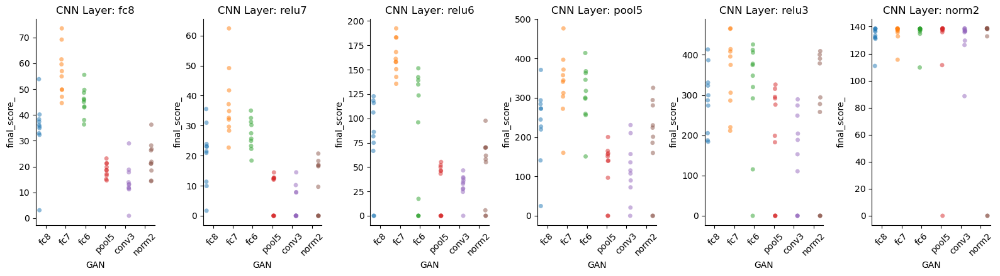

In [42]:
# Create a figure with 6 subplots, one for each CNN layer
fig, axes = plt.subplots(1, 6, figsize=(16, 4.5))
axes = axes.flatten()
# Get unique CNN layers
cnn_layers = df["CNN"].unique()
# Create a subplot for each CNN layer
for i, cnn_layer in enumerate(cnn_layers):
    # Filter data for this CNN layer
    layer_data = df[df["CNN"] == cnn_layer]
    # Create swarm plot
    sns.stripplot(x="GAN", y="final_score_", data=layer_data, ax=axes[i], dodge=True, hue="GAN", alpha=0.5)
    axes[i].set_title(f'CNN Layer: {cnn_layer}')
    axes[i].tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

In [56]:
df[["CNN", "unit_idx", "GAN", "final_score"]].head(12)

,CNN,unit_idx,GAN,final_score
0,fc8,20,fc8,36.180450
1,fc8,20,fc7,54.959850
2,fc8,20,fc6,43.310326
3,fc8,20,pool5,21.337181
4,fc8,20,conv3,13.253426
5,fc8,20,norm2,26.310396
6,relu7,20,fc8,23.147333
7,relu7,20,fc7,28.341131
8,relu7,20,fc6,31.258389
9,relu7,20,pool5,11.998473


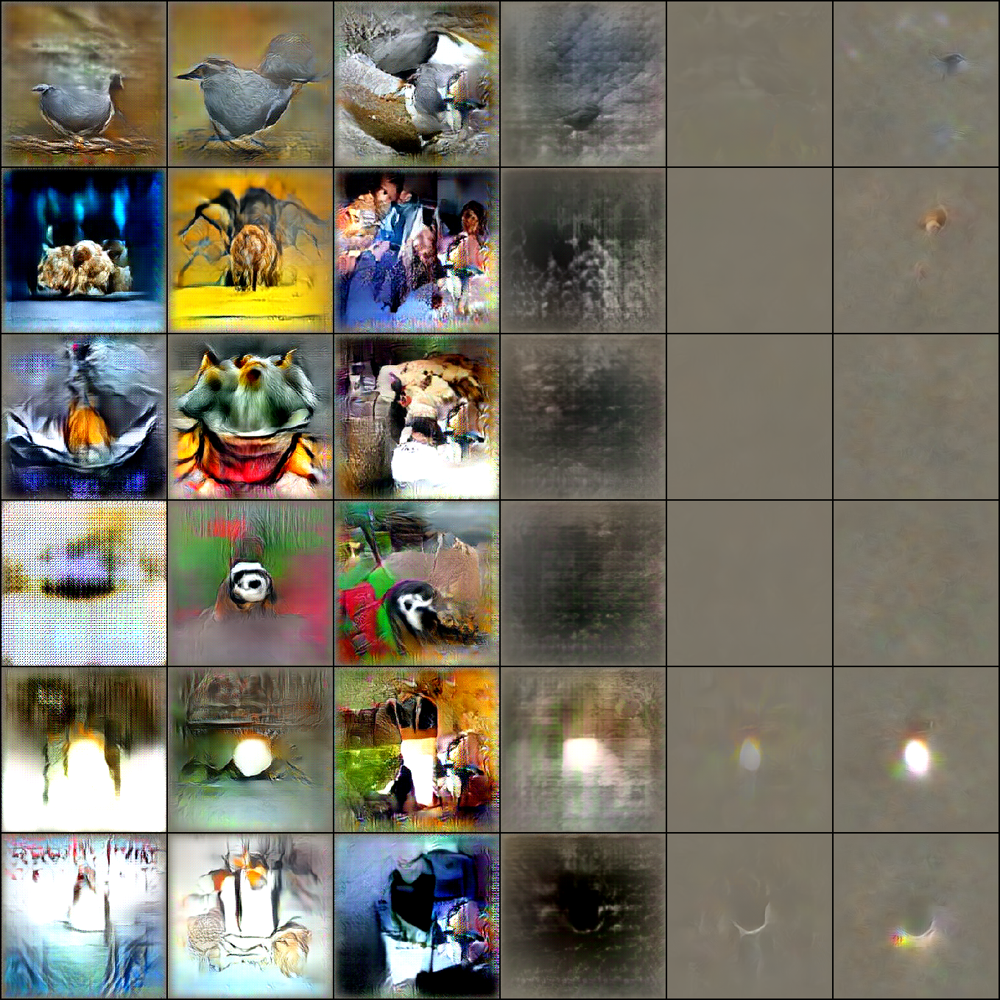

In [53]:
imgcol = []
for i in range(36):
    imgcol.append(df.iloc[i].final_best_img)
display(to_imgrid(imgcol, nrow=6))

In [45]:
df.head()


,CNN,GAN,unit_idx,final_score,final_best_img,scores,generations,final_score_
0,fc8,fc8,20,36.180450,"[[[tensor(0.4216), tensor(0.4654), tensor(0.43...","[-0.4582547, 2.9432032, -0.2385832, -0.3843439...","[0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...",36.180450
1,fc8,fc7,20,54.959850,"[[[tensor(0.4943), tensor(0.4858), tensor(0.49...","[2.2161088, 2.615607, 1.774528, -1.1773475, -0...","[0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...",54.959850
2,fc8,fc6,20,43.310326,"[[[tensor(0.4486), tensor(0.5135), tensor(0.44...","[-2.1635382, -0.70195335, 1.4191985, -1.536072...","[0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...",43.310326
3,fc8,pool5,20,21.337181,"[[[tensor(0.4797), tensor(0.4783), tensor(0.47...","[-0.49314192, 0.61237067, -0.8536985, -0.24546...","[0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...",21.337181
4,fc8,conv3,20,13.253426,"[[[tensor(0.4828), tensor(0.4835), tensor(0.48...","[-0.028890265, 0.07710167, 0.14281896, 0.00523...","[0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...",13.253426


### Pilot 3: Use the correct Rectified layers as optimization objective 

Obsoltet!!!
Forget to add the preprocessing operations!!!


In [ ]:
evolsavedir = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Projects/ReprInvertNet_Evol"

In [43]:
total_steps = 100
print_freq = 100
RFresize = True
corner = (0, 0)
imgsize = (224, 224)
# unit_idx = 20
# layerkey = 'fc7'
# GAN_key = 'fc6'
results_collection = []
for unit_idx in range(20, 30):
    for layerkey in ["fc8", "relu7", "relu6", "pool5", "relu3", "norm2"]:
        for GAN_key in ["fc8", "fc7", "fc6", "pool5", "conv3", "norm2"]:
            print(f"CNN layer: {layerkey}, GAN layer: {GAN_key}")
            G = G_dict[GAN_key]
            fetcher = featureFetcher_module()
            fetcher.record_module(CNN.net.__getattr__(layerkey), target_name=layerkey)
            code_len = np.prod(G.latent_shape)
            optimizer = CholeskyCMAES_torch_noCMA(code_len, init_sigma=1, Aupdate_freq=1000, device='cuda')
            new_codes = torch.randn(1, code_len, device='cuda') #np.random.randn(1, code_len)
            scores_all = []
            generations = []
            codes_all = []
            best_imgs = []
            with torch.no_grad():
                for i in range(total_steps,):
                    codes_all.append(new_codes.cpu().numpy())
                    latent_code = new_codes.view(-1, *G.latent_shape)
                    imgs = G.visualize(latent_code)#.cuda().cpu()
                    if RFresize:
                        imgs = resize_and_pad_tsr(imgs, imgsize, corner, canvas_size=imgsize, )  #  Bug: imgs are resized to 256x256 and it will be further resized in score_tsr
                    CNN(imgs)
                    activations = fetcher[layerkey]
                    if activations.ndim == 2:
                        scores = activations[:, unit_idx] #.cpu().numpy() #scorer.score_tsr(imgs)
                    elif activations.ndim == 4:
                        center_idx = tuple(dim // 2 for dim in activations.shape[-2:])
                        scores = activations[:, unit_idx, center_idx[0], center_idx[1]]
                    else:
                        raise ValueError(f"Unsupported activation dimension: {activations.ndim}")
                    if i % print_freq == 0 or i == total_steps - 1:
                        print("step %d score %.3f (%.3f) (norm %.2f )" % (
                            i, scores.mean().cpu(), scores.std().cpu(), latent_code.norm(dim=1).mean().cpu(),))
                    new_codes = optimizer.step_simple(scores, new_codes, verbosity=False)
                    scores_all.extend(list(scores.cpu().numpy()))
                    generations.extend([i] * len(scores))
                    best_imgs.append(imgs[scores.argmax(),:,:,:].cpu())
            print(f"CNN {layerkey}-unit {unit_idx} | GAN {GAN_key}: last gen avg score: {scores.cpu().mean()}")
            fetcher.cleanup()
            del optimizer
            results_collection.append({
                "CNN": layerkey,
                "GAN": GAN_key,
                "unit_idx": unit_idx,
                "final_score": scores.cpu().mean().item(),
                "final_best_img": best_imgs[-1].cpu(),
                "scores": scores_all,
                "generations": generations,
                # "best_imgs": best_imgs,
            })


CNN layer: fc8, GAN layer: fc8
FeatureFetcher hooks all freed
Space dimension: 1000, Population size: 33, Select size:16, Optimization Parameters:
Initial sigma: 1.000
cc=0.004, cs=0.089, c1=0.000, damps=1.089
step 0 score -0.034 (nan) (norm 32.30 )


/tmp/ipykernel_3432614/1937004536.py:42: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at /opt/conda/conda-bld/pytorch_1716905979055/work/aten/src/ATen/native/ReduceOps.cpp:1807.)
  i, scores.mean().cpu(), scores.std().cpu(), latent_code.norm(dim=1).mean().cpu(),))


step 99 score 3.173 (0.175) (norm 102.88 )
CNN fc8-unit 20 | GAN fc8: last gen avg score: 3.1726508140563965
FeatureFetcher hooks all freed
CNN layer: fc8, GAN layer: fc7
FeatureFetcher hooks all freed
Space dimension: 4096, Population size: 40, Select size:20, Optimization Parameters:
Initial sigma: 1.000
cc=0.001, cs=0.050, c1=0.000, damps=1.050
step 0 score -0.067 (nan) (norm 64.86 )
step 99 score 4.591 (0.183) (norm 179.55 )
CNN fc8-unit 20 | GAN fc7: last gen avg score: 4.591317176818848
FeatureFetcher hooks all freed
CNN layer: fc8, GAN layer: fc6
FeatureFetcher hooks all freed
Space dimension: 4096, Population size: 40, Select size:20, Optimization Parameters:
Initial sigma: 1.000
cc=0.001, cs=0.050, c1=0.000, damps=1.050
step 0 score -0.044 (nan) (norm 64.79 )
step 99 score 1.934 (0.228) (norm 180.72 )
CNN fc8-unit 20 | GAN fc6: last gen avg score: 1.9344151020050049
FeatureFetcher hooks all freed
CNN layer: fc8, GAN layer: pool5
FeatureFetcher hooks all freed
Space dimension: 

In [44]:

pkl.dump(results_collection, open(f"{evolsavedir}/results_collection_noCMA_pilot3.pkl", "wb"))

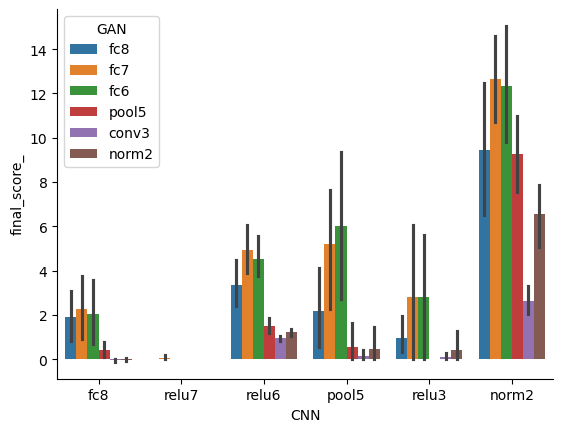

In [46]:
df = pd.DataFrame(results_collection)
df.head()
df["final_score_"] = df["final_score"]#.map(lambda x:x.item())
sns.barplot(x="CNN", y="final_score_", data=df, hue="GAN", )
plt.show()

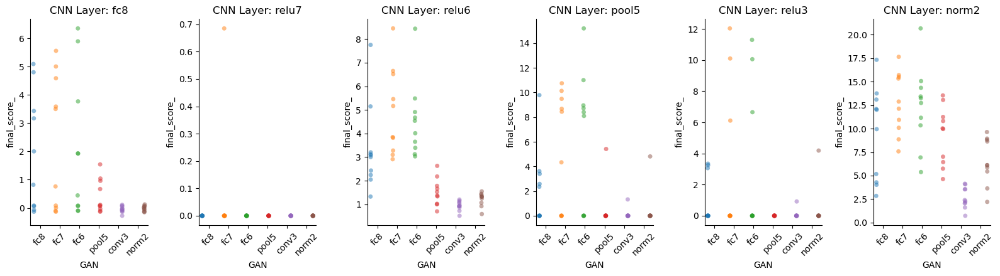

In [55]:
# Create a figure with 6 subplots, one for each CNN layer
fig, axes = plt.subplots(1, 6, figsize=(16, 4.5))
axes = axes.flatten()
# Get unique CNN layers
cnn_layers = df["CNN"].unique()
# Create a subplot for each CNN layer
for i, cnn_layer in enumerate(cnn_layers):
    # Filter data for this CNN layer
    layer_data = df[df["CNN"] == cnn_layer]
    # Create swarm plot
    sns.stripplot(x="GAN", y="final_score_", data=layer_data, ax=axes[i], dodge=True, hue="GAN", alpha=0.5)
    axes[i].set_title(f'CNN Layer: {cnn_layer}')
    axes[i].tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

### Pilot 2

Obsoltet!!!
Forgot to hook the rectified layers, not really inversion.


In [23]:
total_steps = 100
print_freq = 100
RFresize = True
corner = (0, 0)
imgsize = (224, 224)

unit_idx = 20
layerkey = 'fc7'
GAN_key = 'fc6'
results_collection = []
for unit_idx in range(20, 30):
    for layerkey in ["fc8", "fc7", "fc6", "pool5", "conv3", "norm2"]:
        for GAN_key in ["fc8", "fc7", "fc6", "pool5", "conv3", "norm2"]:
            print(f"CNN layer: {layerkey}, GAN layer: {GAN_key}")
            G = G_dict[GAN_key]
            fetcher = featureFetcher_module()
            fetcher.record_module(CNN.net.__getattr__(layerkey), target_name=layerkey)
            code_len = np.prod(G.latent_shape)
            optimizer = CholeskyCMAES_torch_noCMA(code_len, init_sigma=1, Aupdate_freq=1000, device='cuda')
            new_codes = torch.randn(1, code_len, device='cuda') #np.random.randn(1, code_len)
            scores_all = []
            generations = []
            codes_all = []
            best_imgs = []
            with torch.no_grad():
                for i in range(total_steps,):
                    codes_all.append(new_codes.cpu().numpy())
                    latent_code = new_codes.view(-1, *G.latent_shape)
                    imgs = G.visualize(latent_code)#.cuda().cpu()
                    if RFresize:
                        imgs = resize_and_pad_tsr(imgs, imgsize, corner, canvas_size=imgsize, )  #  Bug: imgs are resized to 256x256 and it will be further resized in score_tsr
                    CNN(imgs)
                    activations = fetcher[layerkey]
                    if activations.ndim == 2:
                        scores = activations[:, unit_idx] #.cpu().numpy() #scorer.score_tsr(imgs)
                    elif activations.ndim == 4:
                        center_idx = tuple(dim // 2 for dim in activations.shape[-2:])
                        scores = activations[:, unit_idx, center_idx[0], center_idx[1]]
                    else:
                        raise ValueError(f"Unsupported activation dimension: {activations.ndim}")
                    if i % print_freq == 0 or i == total_steps - 1:
                        print("step %d score %.3f (%.3f) (norm %.2f )" % (
                            i, scores.mean().cpu(), scores.std().cpu(), latent_code.norm(dim=1).mean().cpu(),))
                    new_codes = optimizer.step_simple(scores, new_codes, verbosity=False)
                    scores_all.extend(list(scores.cpu().numpy()))
                    generations.extend([i] * len(scores))
                    best_imgs.append(imgs[scores.argmax(),:,:,:].cpu())
            print(f"CNN {layerkey}-unit {unit_idx} | GAN {GAN_key}: last gen avg score: {scores.cpu().mean()}")
            fetcher.cleanup()
            del optimizer
            results_collection.append({
                "CNN": layerkey,
                "GAN": GAN_key,
                "unit_idx": unit_idx,
                "final_score": scores.cpu().mean().item(),
                "scores": scores_all,
                "generations": generations,
                # "best_imgs": best_imgs,
            })


CNN layer: fc8, GAN layer: fc8
FeatureFetcher hooks all freed
Space dimension: 1000, Population size: 33, Select size:16, Optimization Parameters:
Initial sigma: 1.000
cc=0.004, cs=0.089, c1=0.000, damps=1.089
step 0 score -0.032 (nan) (norm 30.28 )


/tmp/ipykernel_3432614/4079056408.py:43: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at /opt/conda/conda-bld/pytorch_1716905979055/work/aten/src/ATen/native/ReduceOps.cpp:1807.)
  i, scores.mean().cpu(), scores.std().cpu(), latent_code.norm(dim=1).mean().cpu(),))


step 99 score 0.997 (0.130) (norm 104.70 )
CNN fc8-unit 20 | GAN fc8: last gen avg score: 0.9971204996109009
FeatureFetcher hooks all freed
CNN layer: fc8, GAN layer: fc7
FeatureFetcher hooks all freed
Space dimension: 4096, Population size: 40, Select size:20, Optimization Parameters:
Initial sigma: 1.000
cc=0.001, cs=0.050, c1=0.000, damps=1.050
step 0 score -0.033 (nan) (norm 63.39 )
step 99 score 3.904 (0.166) (norm 177.36 )
CNN fc8-unit 20 | GAN fc7: last gen avg score: 3.9042580127716064
FeatureFetcher hooks all freed
CNN layer: fc8, GAN layer: fc6
FeatureFetcher hooks all freed
Space dimension: 4096, Population size: 40, Select size:20, Optimization Parameters:
Initial sigma: 1.000
cc=0.001, cs=0.050, c1=0.000, damps=1.050
step 0 score -0.040 (nan) (norm 64.40 )
step 99 score 2.284 (0.160) (norm 176.75 )
CNN fc8-unit 20 | GAN fc6: last gen avg score: 2.2842304706573486
FeatureFetcher hooks all freed
CNN layer: fc8, GAN layer: pool5
FeatureFetcher hooks all freed
Space dimension:

In [27]:
!du -sh {savedir}/*

25M	/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Projects/ReprInvertNet_Evol/results_collection_noCMA.pkl
11M	/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Projects/ReprInvertNet_Evol/results_collection.pkl


In [24]:
pkl.dump(results_collection, open(f"{evolsavedir}/results_collection_noCMA.pkl", "wb"))

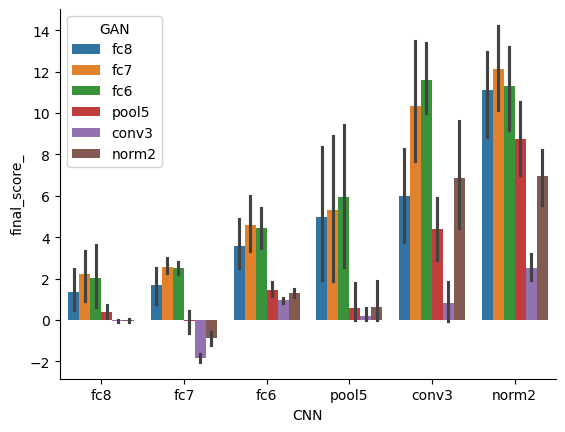

In [25]:
df = pd.DataFrame(results_collection)
df.head()
df["final_score_"] = df["final_score"].map(lambda x:x.item())
sns.barplot(x="CNN", y="final_score_", data=df, hue="GAN", )
plt.show()

### Pilot 1

Obsoltet!!!
Forgot to hook the rectified layers, not really inversion.


In [4]:
total_steps = 100
print_freq = 100
RFresize = True
corner = (0, 0)
imgsize = (224, 224)

unit_idx = 20
layerkey = 'fc7'
GAN_key = 'fc6'
results_collection = []
for unit_idx in range(10, 20):
    for layerkey in ["fc8", "fc6", "pool5", "conv3", ]:
        for GAN_key in ["fc8", "fc6", "pool5", "conv3", ]:
            print(f"CNN layer: {layerkey}, GAN layer: {GAN_key}")
            G = G_dict[GAN_key]
            fetcher = featureFetcher_module()
            fetcher.record_module(CNN.net.__getattr__(layerkey), target_name=layerkey)
            code_len = np.prod(G.latent_shape)
            optimizer = CholeskyCMAES_torch(code_len, init_sigma=1, Aupdate_freq=1000, device='cuda')
            new_codes = torch.randn(1, code_len, device='cuda') #np.random.randn(1, code_len)
            scores_all = []
            generations = []
            codes_all = []
            best_imgs = []
            with torch.no_grad():
                for i in range(total_steps,):
                    codes_all.append(new_codes.cpu().numpy())
                    latent_code = new_codes.view(-1, *G.latent_shape)
                    imgs = G.visualize(latent_code)#.cuda().cpu()
                    if RFresize:
                        imgs = resize_and_pad_tsr(imgs, imgsize, corner, canvas_size=imgsize, )  #  Bug: imgs are resized to 256x256 and it will be further resized in score_tsr
                    CNN(imgs)
                    activations = fetcher[layerkey]
                    if activations.ndim == 2:
                        scores = activations[:, unit_idx] #.cpu().numpy() #scorer.score_tsr(imgs)
                    elif activations.ndim == 4:
                        center_idx = tuple(dim // 2 for dim in activations.shape[-2:])
                        scores = activations[:, unit_idx, center_idx[0], center_idx[1]]
                    else:
                        raise ValueError(f"Unsupported activation dimension: {activations.ndim}")
                    if i % print_freq == 0 or i == total_steps - 1:
                        print("step %d score %.3f (%.3f) (norm %.2f )" % (
                            i, scores.mean().cpu(), scores.std().cpu(), latent_code.norm(dim=1).mean().cpu(),))
                    new_codes = optimizer.step_simple(scores, new_codes, verbosity=False)
                    scores_all.extend(list(scores.cpu().numpy()))
                    generations.extend([i] * len(scores))
                    best_imgs.append(imgs[scores.argmax(),:,:,:].cpu())
            print(f"CNN {layerkey}-unit {unit_idx} | GAN {GAN_key}: last gen avg score: {scores.cpu().mean()}")
            fetcher.cleanup()
            del optimizer
            results_collection.append({
                "CNN": layerkey,
                "GAN": GAN_key,
                "unit_idx": unit_idx,
                "final_score": scores.cpu().mean(),
                "scores": scores_all,
                "generations": generations,
                # "best_imgs": best_imgs,
            })


CNN layer: fc8, GAN layer: fc8
Space dimension: 1000, Population size: 33, Select size:16, Optimization Parameters:
Initial sigma: 1.000
cc=0.004, cs=0.089, c1=0.000, damps=1.089
step 0 score -0.181 (nan) (norm 32.28 )


/tmp/ipykernel_3432614/1011154020.py:43: UserWarning: std(): degrees of freedom is <= 0. Correction should be strictly less than the reduction factor (input numel divided by output numel). (Triggered internally at /opt/conda/conda-bld/pytorch_1716905979055/work/aten/src/ATen/native/ReduceOps.cpp:1807.)
  i, scores.mean().cpu(), scores.std().cpu(), latent_code.norm(dim=1).mean().cpu(),))


step 99 score -0.046 (0.024) (norm 95.97 )
CNN fc8-unit 10 | GAN fc8: last gen avg score: -0.04578453302383423
FeatureFetcher hooks all freed
CNN layer: fc8, GAN layer: fc6
FeatureFetcher hooks all freed
Space dimension: 4096, Population size: 40, Select size:20, Optimization Parameters:
Initial sigma: 1.000
cc=0.001, cs=0.050, c1=0.000, damps=1.050
step 0 score -0.150 (nan) (norm 64.71 )
step 99 score 3.590 (0.139) (norm 178.75 )
CNN fc8-unit 10 | GAN fc6: last gen avg score: 3.589848756790161
FeatureFetcher hooks all freed
CNN layer: fc8, GAN layer: pool5
FeatureFetcher hooks all freed
Space dimension: 9216, Population size: 43, Select size:21, Optimization Parameters:
Initial sigma: 1.000
cc=0.000, cs=0.035, c1=0.000, damps=1.035
step 0 score -0.181 (nan) (norm 16.10 )
step 99 score 0.625 (0.022) (norm 42.81 )
CNN fc8-unit 10 | GAN pool5: last gen avg score: 0.6252414584159851
FeatureFetcher hooks all freed
CNN layer: fc8, GAN layer: conv3
FeatureFetcher hooks all freed
Space dimens

In [5]:
len(results_collection)

160

In [11]:
!mkdir $STORE_DIR/Projects/ReprInvertNet_Evol

In [20]:
results_collection[0]

{'CNN': 'fc8',
 'GAN': 'fc8',
 'unit_idx': 10,
 'final_score': tensor(-0.0458),
 'scores': [-0.18050596,
  -0.17883037,
  -0.15189599,
  -0.1572567,
  -0.17443334,
  -0.14550802,
  -0.16473062,
  -0.17916864,
  -0.1536218,
  -0.175437,
  -0.16895932,
  -0.17765294,
  -0.15787736,
  -0.14029258,
  -0.16167806,
  -0.17978221,
  -0.15514973,
  -0.17692089,
  -0.15641189,
  -0.1492818,
  -0.17842296,
  -0.17901707,
  -0.17357734,
  -0.16898553,
  -0.14497024,
  -0.17548503,
  -0.17496495,
  -0.17008382,
  -0.17339005,
  -0.1534576,
  -0.13759932,
  -0.17913254,
  -0.1793076,
  -0.14661992,
  -0.15791254,
  -0.15809074,
  -0.14445063,
  -0.17681468,
  -0.13709141,
  -0.15371992,
  -0.13918245,
  -0.14558312,
  -0.1215268,
  -0.17665318,
  -0.1497402,
  -0.15997103,
  -0.1593918,
  -0.15100071,
  -0.17898384,
  -0.15284006,
  -0.15906052,
  -0.15124217,
  -0.1604757,
  -0.15465307,
  -0.15071598,
  -0.13174692,
  -0.13871224,
  -0.15935278,
  -0.16472177,
  -0.15643448,
  -0.17123279,
  -0.1

In [14]:
evolsavedir = "/n/holylfs06/LABS/kempner_fellow_binxuwang/Users/binxuwang/Projects/ReprInvertNet_Evol"
pkl.dump(results_collection, open(f"{evolsavedir}/results_collection.pkl", "wb"))

In [16]:
df = pd.DataFrame(results_collection)
df.head()
df["final_score_"] = df["final_score"].map(lambda x:x.item())

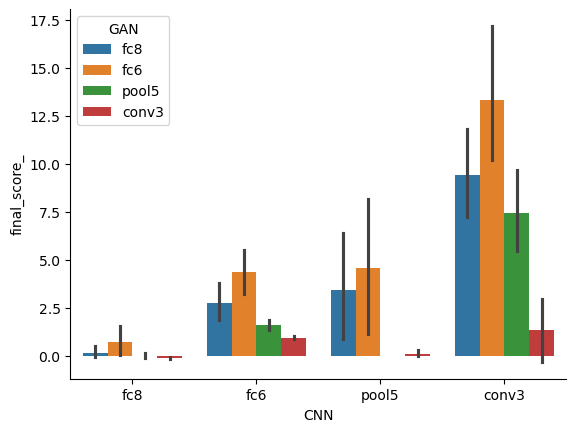

In [18]:
sns.barplot(x="CNN", y="final_score_", data=df, hue="GAN", )
plt.show()

### scratch space

In [13]:
total_steps = 100
print_freq = 100
RFresize = True
corner = (0, 0)
imgsize = (224, 224)

unit_idx = 20
layerkey = 'fc7'
GAN_key = 'fc6'
results_collection = []
for unit_idx in range(10, 20):
    for layerkey in ["fc6", "pool5", "conv3", "norm2"]:
        for GAN_key in ["fc6", "pool5", "conv3", "norm2"]:
            print(f"CNN layer: {layerkey}, GAN layer: {GAN_key}")
            G = G_dict[GAN_key]
            fetcher = featureFetcher_module()
            fetcher.record_module(CNN.net.__getattr__(layerkey), target_name=layerkey)
            optimizer = CholeskyCMAES(np.prod(G.latent_shape), init_sigma=3, Aupdate_freq=1000)
            code_len = np.prod(G.latent_shape)
            new_codes = np.random.randn(1, code_len)
            scores_all = []
            generations = []
            codes_all = []
            best_imgs = []
            with torch.no_grad():
                for i in range(total_steps,):
                    codes_all.append(new_codes.copy())
                    latent_code = torch.from_numpy(np.array(new_codes)).float()
                    latent_code = latent_code.view(-1, *G.latent_shape)
                    imgs = G.visualize(latent_code.cuda())#.cpu()
                    if RFresize:
                        imgs = resize_and_pad_tsr(imgs, imgsize, corner, canvas_size=imgsize, )  #  Bug: imgs are resized to 256x256 and it will be further resized in score_tsr
                    CNN(imgs)
                    activations = fetcher[layerkey]
                    scores = activations[:, unit_idx].cpu().numpy() #scorer.score_tsr(imgs)
                    if i % print_freq == 0 or i == total_steps - 1:
                        print("step %d score %.3f (%.3f) (norm %.2f )" % (
                            i, scores.mean(), scores.std(), latent_code.norm(dim=1).mean(),))
                    new_codes = optimizer.step_simple(scores, new_codes, verbosity=False)
                    scores_all.extend(list(scores))
                    generations.extend([i] * len(scores))
                    best_imgs.append(imgs[scores.argmax(),:,:,:].cpu())
            print(f"CNN {layerkey}-unit {unit_idx} | GAN {GAN_key}: last gen avg score: {scores.mean()}")
            fetcher.cleanup()
            results_collection.append({
                "CNN": layerkey,
                "GAN": GAN_key,
                "unit_idx": unit_idx,
                "final_score": scores.mean(),
                "scores": scores_all,
                "generations": generations,
                "best_imgs": best_imgs,
            })


CNN layer: fc6, GAN layer: fc6
Space dimension: 4096, Population size: 40, Select size:20, Optimization Parameters:
Initial sigma: 3.000
cc=0.001, cs=0.050, c1=0.000 damps=1.050
step 0 score 0.927 (0.000) (norm 64.21 )
step 99 score 7.589 (0.201) (norm 505.63 )
CNN fc6-unit 10 | GAN fc6: last gen avg score: 7.588764190673828
FeatureFetcher hooks all freed
CNN layer: fc6, GAN layer: pool5
FeatureFetcher hooks all freed
Space dimension: 9216, Population size: 43, Select size:21, Optimization Parameters:
Initial sigma: 3.000
cc=0.000, cs=0.035, c1=0.000 damps=1.035
step 0 score 1.036 (0.000) (norm 15.95 )
step 99 score 5.061 (0.094) (norm 117.86 )
CNN fc6-unit 10 | GAN pool5: last gen avg score: 5.0608110427856445
FeatureFetcher hooks all freed
CNN layer: fc6, GAN layer: conv3
FeatureFetcher hooks all freed
Space dimension: 64896, Population size: 51, Select size:25, Optimization Parameters:
Initial sigma: 3.000
cc=0.000, cs=0.015, c1=0.000 damps=1.015
step 0 score 1.054 (0.000) (norm 19.

KeyboardInterrupt: 

In [ ]:
total_steps = 100
print_freq = 100
RFresize = True
corner = (0, 0)
imgsize = (224, 224)

unit_idx = 20
layerkey = 'fc7'
GAN_key = 'fc6'
results_collection = []
for unit_idx in range(10, 20):
    for layerkey in ["fc6", "fc7", "fc8"]:
        for GAN_key in ["fc6", "fc7", "fc8"]:
            print(f"CNN layer: {layerkey}, GAN layer: {GAN_key}")
            G = G_dict[GAN_key]
            fetcher = featureFetcher_module()
            fetcher.record_module(CNN.net.__getattr__(layerkey), target_name=layerkey)
            optimizer = CholeskyCMAES(np.prod(G.latent_shape), init_sigma=3)
            new_codes = np.random.randn(1, *G.latent_shape)
            scores_all = []
            generations = []
            codes_all = []
            best_imgs = []
            with torch.no_grad():
                for i in range(total_steps,):
                    codes_all.append(new_codes.copy())
                    latent_code = torch.from_numpy(np.array(new_codes)).float()
                    latent_code = latent_code.view(-1, *G.latent_shape)
                    imgs = G.visualize(latent_code.cuda())#.cpu()
                    if RFresize:
                        imgs = resize_and_pad_tsr(imgs, imgsize, corner, canvas_size=imgsize, )  #  Bug: imgs are resized to 256x256 and it will be further resized in score_tsr
                    CNN(imgs)
                    activations = fetcher[layerkey]
                    scores = activations[:, unit_idx].cpu().numpy() #scorer.score_tsr(imgs)
                    if i % print_freq == 0 or i == total_steps - 1:
                        print("step %d score %.3f (%.3f) (norm %.2f )" % (
                            i, scores.mean(), scores.std(), latent_code.norm(dim=1).mean(),))
                    new_codes = optimizer.step_simple(scores, new_codes, verbosity=False)
                    scores_all.extend(list(scores))
                    generations.extend([i] * len(scores))
                    best_imgs.append(imgs[scores.argmax(),:,:,:].cpu())
            print(f"CNN {layerkey}-unit {unit_idx} | GAN {GAN_key}: last gen avg score: {scores.mean()}")
            fetcher.cleanup()
            results_collection.append({
                "CNN": layerkey,
                "GAN": GAN_key,
                "unit_idx": unit_idx,
                "final_score": scores.mean(),
                "scores": scores_all,
                "generations": generations,
                "best_imgs": best_imgs,
            })


In [47]:
total_steps = 100
print_freq = 100
RFresize = True
corner = (0, 0)
imgsize = (224, 224)

unit_idx = 20
layerkey = 'fc7'
GAN_key = 'fc6'
results_collection = []
for unit_idx in range(10, 20):
    for layerkey in ["fc6", "fc7", "fc8"]:
        for GAN_key in ["fc6", "fc7", "fc8"]:
            print(f"CNN layer: {layerkey}, GAN layer: {GAN_key}")
            G = G_dict[GAN_key]
            fetcher = featureFetcher_module()
            fetcher.record_module(CNN.net.__getattr__(layerkey), target_name=layerkey)
            optimizer = CholeskyCMAES(np.prod(G.latent_shape), init_sigma=3)
            new_codes = np.random.randn(1, *G.latent_shape)
            scores_all = []
            generations = []
            codes_all = []
            best_imgs = []
            with torch.no_grad():
                for i in range(total_steps,):
                    codes_all.append(new_codes.copy())
                    latent_code = torch.from_numpy(np.array(new_codes)).float()
                    latent_code = latent_code.view(-1, *G.latent_shape)
                    imgs = G.visualize(latent_code.cuda())#.cpu()
                    if RFresize:
                        imgs = resize_and_pad_tsr(imgs, imgsize, corner, canvas_size=imgsize, )  #  Bug: imgs are resized to 256x256 and it will be further resized in score_tsr
                    CNN(imgs)
                    activations = fetcher[layerkey]
                    scores = activations[:, unit_idx].cpu().numpy() #scorer.score_tsr(imgs)
                    if i % print_freq == 0 or i == total_steps - 1:
                        print("step %d score %.3f (%.3f) (norm %.2f )" % (
                            i, scores.mean(), scores.std(), latent_code.norm(dim=1).mean(),))
                    new_codes = optimizer.step_simple(scores, new_codes, verbosity=False)
                    scores_all.extend(list(scores))
                    generations.extend([i] * len(scores))
                    best_imgs.append(imgs[scores.argmax(),:,:,:].cpu())
            print(f"CNN {layerkey}-unit {unit_idx} | GAN {GAN_key}: last gen avg score: {scores.mean()}")
            fetcher.cleanup()
            results_collection.append({
                "CNN": layerkey,
                "GAN": GAN_key,
                "unit_idx": unit_idx,
                "final_score": scores.mean(),
                "scores": scores_all,
                "generations": generations,
                "best_imgs": best_imgs,
            })


CNN layer: fc6, GAN layer: fc6
FeatureFetcher hooks all freed
Space dimension: 4096, Population size: 40, Select size:20, Optimization Parameters:
Initial sigma: 3.000
cc=0.001, cs=0.050, c1=0.000 damps=1.050
step 0 score 0.959 (0.000) (norm 64.18 )
step 99 score 7.442 (0.236) (norm 497.79 )
CNN fc6-unit 10 | GAN fc6: last gen avg score: 7.441703796386719
FeatureFetcher hooks all freed
CNN layer: fc6, GAN layer: fc7
FeatureFetcher hooks all freed
Space dimension: 4096, Population size: 40, Select size:20, Optimization Parameters:
Initial sigma: 3.000
cc=0.001, cs=0.050, c1=0.000 damps=1.050
step 0 score 0.928 (0.000) (norm 65.52 )
step 99 score 3.019 (0.187) (norm 473.49 )
CNN fc6-unit 10 | GAN fc7: last gen avg score: 3.018674373626709
FeatureFetcher hooks all freed
CNN layer: fc6, GAN layer: fc8
FeatureFetcher hooks all freed
Space dimension: 1000, Population size: 33, Select size:16, Optimization Parameters:
Initial sigma: 3.000
cc=0.004, cs=0.089, c1=0.000 damps=1.089
step 0 score 

OutOfMemoryError: CUDA out of memory. Tried to allocate 80.00 MiB. GPU 

In [15]:
scores.shape

torch.Size([1])

In [13]:
activations.shape

torch.Size([1, 4096])